# Section One Dataset

The "AG News" dataset consists two rows "text" and "label". The "text" column consists of news headlines and a short summary of the article, in many cases the name of the news agency the article is from is also included. The "label" column consists of 4 labels numbered 0-3. Theses class labels are nominal (distinct).

Where:
  0 = "World"
  1 = "Sports"
  2 = "Business"
  3 = "Sci/Tec"

The dataset consists of 120,000 rows. The dataset is balanced across all 4 labels, each making up 25% of the rows.

The task to be performed is multi-class text-classification. Where the algorithms will train to predict which label each text has. Then attempt to use what they've learned to predict labels for the test set. All four labels will be used in this coursework.

In [2]:
import pandas as pd

#get dataset from huggingFace
splits = {'train': 'data/train-00000-of-00001.parquet', 'test': 'data/test-00000-of-00001.parquet'}
df = pd.read_parquet("hf://datasets/wangrongsheng/ag_news/" + splits["train"])

first_entry = df['text'].iloc[0]
print(first_entry)

df

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Wall St. Bears Claw Back Into the Black (Reuters) Reuters - Short-sellers, Wall Street's dwindling\band of ultra-cynics, are seeing green again.


,text,label
0,Wall St. Bears Claw Back Into the Black (Reute...,2
1,Carlyle Looks Toward Commercial Aerospace (Reu...,2
2,Oil and Economy Cloud Stocks' Outlook (Reuters...,2
3,Iraq Halts Oil Exports from Main Southern Pipe...,2
4,"Oil prices soar to all-time record, posing new...",2
...,...,...
119995,Pakistan's Musharraf Says Won't Quit as Army C...,0
119996,Renteria signing a top-shelf deal Red Sox gene...,1
119997,Saban not going to Dolphins yet The Miami Dolp...,1
119998,Today's NFL games PITTSBURGH at NY GIANTS Time...,1


In [3]:
#seperate text and labels
x = df['text']
y = df['label']

print(x)
print(y)

0         Wall St. Bears Claw Back Into the Black (Reute...
1         Carlyle Looks Toward Commercial Aerospace (Reu...
2         Oil and Economy Cloud Stocks' Outlook (Reuters...
3         Iraq Halts Oil Exports from Main Southern Pipe...
4         Oil prices soar to all-time record, posing new...
                                ...                        
119995    Pakistan's Musharraf Says Won't Quit as Army C...
119996    Renteria signing a top-shelf deal Red Sox gene...
119997    Saban not going to Dolphins yet The Miami Dolp...
119998    Today's NFL games PITTSBURGH at NY GIANTS Time...
119999    Nets get Carter from Raptors INDIANAPOLIS -- A...
Name: text, Length: 120000, dtype: object
0         2
1         2
2         2
3         2
4         2
         ..
119995    0
119996    1
119997    1
119998    1
119999    1
Name: label, Length: 120000, dtype: int64


In [4]:
#Pre-Processing
import nltk

nltk.download('stopwords')
nltk.download('punkt')
nltk.download('punkt_tab')

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.snowball import SnowballStemmer


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


In [5]:
def pre_process(text):
  preprocessed_text = []
  for sentence in text:
    token_text = word_tokenize(sentence) #tokenize
    normd_text = [word.lower() for word in token_text] #normalize

    #create stop word list
    stop_words = stopwords.words('english')
    #add news agent based stop words
    stop_words.extend(["associated", "ap", "reuters", "broadcasting", "bbc", "al", "agence", "afp", "sky", "rt", "global", "cgtn", "cable", "cnn", "fox", "nbc", "abc", "columbia", "cbs", "public", "pbs", "new", "nyt", "wall", "wsj", "bloomberg", "politico", "vox", "guardian", "telegraph", "independent", "financial", "ft", "euronews", "repubblica", "frankfurter", "faz", "spiegel", "times", "toi", "scmp", "straits", "kyodo", "nikkei", "asahi", "yonhap", "sbs", "mail", "daily", "middle", "mee", "haaretz", "arab", "tech"])
    stop_words_text = [token for token in normd_text if token not in stop_words]

    #stemming
    stemmer = SnowballStemmer('english')
    preprocessed_text += [[stemmer.stem(word) for word in stop_words_text]]

  prep_sentences = [" ".join(sentence) for sentence in preprocessed_text] #we join the sentences back together to ensure compatibility with CountVec, which is doing some of it's own prep
  return prep_sentences

prep_x = pre_process(x)
#prep_x.head()

In [ ]:
print(prep_x)

["st. bear claw back black ( ) - short-sel , street 's dwindling\\band ultra-cyn , see green .", 'carlyl look toward commerci aerospac ( ) - privat invest firm carlyl group , \\which reput make well-tim occasionally\\controversi play defens industri , quiet placed\\it bet anoth part market .', "oil economi cloud stock ' outlook ( ) - soar crude price plus worries\\about economi outlook earn expect to\\hang stock market next week depth the\\summ doldrum .", 'iraq halt oil export main southern pipelin ( ) - author halt oil export\\flow main pipelin southern iraq after\\intellig show rebel militia could strike\\infrastructur , oil offici said saturday .', 'oil price soar all-tim record , pose menac us economi ( ) - tearaway world oil price , toppl record strain wallet , present econom menac bare three month us presidenti elect .', 'stock end , near year low ( ) - stock end slight higher friday\\but stay near low year oil price surg past # 36 ; 46\\a barrel , offset posit outlook comput ma

# Section Two Rep Learning

The representation technique used here is GloVe (Global Vectors for Word Representation). Like Word2Vec (W2V), glove is a word embedder that shows semantic relationships between words (co-occurrence). However, where it differs is in scope, where W2V uses local context windows only, GloVe also uses global matrix factorization over the entire corpus. The matrix is constructed by counting how many times a word occurs in the context of another word. Using this matrix, the sum of co-occurrence probabilities of words is calculated to identify meaningful relationships. Probability ratios are then determined by comparing the probability of one word relative to another with a shared context word. To ensure frequent words do not overly dominate the representations, co-occurrence is weighted by factorizing the log of the matrix entries. This normalizes the representation otherwise frequent word counts could be significantly larger than rarer words depending on the corpus. GloVe uses a weighted least squares loss function, where the weighting function caps the impact of frequent word pairs, preventing their over-representation in the final embeddings.

In [6]:
!wget http://nlp.stanford.edu/data/glove.6B.zip
!unzip glove*.zip

--2024-12-04 15:21:46--  http://nlp.stanford.edu/data/glove.6B.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.zip [following]
--2024-12-04 15:21:46--  https://nlp.stanford.edu/data/glove.6B.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip [following]
--2024-12-04 15:21:46--  https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 862182613 (822M) [application/zip]
Saving to: ‘glove.6B.zip’

glov

In [7]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np

tokenizer = Tokenizer()
tokenizer.fit_on_texts(prep_x)

print( len(tokenizer.word_index))
print( tokenizer.word_index)

def embedding_for_vocab(filepath, word_index,
                        embedding_dim):
    vocab_size = len(word_index) + 1

    # Adding again 1 because of reserved 0 index
    embedding_matrix_vocab = np.zeros((vocab_size,
                                       embedding_dim))

    with open(filepath, encoding="utf8") as f:
        for line in f:
            word, *vector = line.split()
            if word in word_index:
                idx = word_index[word]
                embedding_matrix_vocab[idx] = np.array(
                    vector, dtype=np.float32)[:embedding_dim]

    return embedding_matrix_vocab


49457
{'39': 1, "'s": 2, 'said': 3, 'year': 4, 'us': 5, 'gt': 6, 'lt': 7, 'quot': 8, 'two': 9, "''": 10, 'compani': 11, 'first': 12, 'world': 13, 'say': 14, 'report': 15, 'u': 16, '1': 17, 'one': 18, 'game': 19, 'monday': 20, 'oil': 21, 'wednesday': 22, 'tuesday': 23, 'thursday': 24, 's': 25, 'week': 26, '2': 27, 'state': 28, 'win': 29, 'price': 30, 'friday': 31, 'inc': 32, 'last': 33, 'plan': 34, 'unit': 35, 'b': 36, 'iraq': 37, 'million': 38, 'york': 39, 'day': 40, 'kill': 41, 'presid': 42, 'yesterday': 43, 'secur': 44, 'open': 45, 'three': 46, 'microsoft': 47, 'nation': 48, 'back': 49, 'end': 50, 'offici': 51, 'group': 52, 'servic': 53, 'team': 54, 'govern': 55, 'corp': 56, 'month': 57, 'market': 58, 'stock': 59, 'com': 60, 'sunday': 61, 'could': 62, 'take': 63, 'second': 64, 'lead': 65, 'would': 66, 'announc': 67, 'time': 68, '3': 69, 'today': 70, 'n': 71, 'peopl': 72, 'make': 73, 'season': 74, 'may': 75, 'sale': 76, 'high': 77, 'percent': 78, 'record': 79, 'share': 80, 'softwar': 

# Section Three Algorithms

# FNN

A FeedForward Neural Network (fnn) is a unidirectional machine learning algorithm meaning that it doesn’t use cycles. Making it inappropriate for continuous data but since this dataset uses discrete labels it is effective here. It consists of at least 3 layers. An input layer, at least one hidden layer, and an output layer.

The input layer consists of multiple neurons that receive input data, the number of neurons consistent with the number of features in a dataset.

The hidden layers are where the actual learning takes place. Where each neuron performs a weighted sum of inputs followed by an activation function. The activation function being used here is a rectified linear unit (relu) function. Where if the weighted sum from the previous layer is less than or equal to zero the output will be zero otherwise the output will be directly proportional to the input.  

Then is the output layer where the number of neurons is equivalent to the number of classes, in this dataset there are 4 classes, so the output layer has 4 neurons. The output layer here uses softmax. Softmax is applied here to get probability distribution summing up to 1.

The loss function being applied here is sparse categorical cross entropy (SCCE). Where “sparse” here means that the labels are integers rather than one-hot encoders. (e.g labels 0, 1, 2, 3). Working by taking the negative log of the probability assigned to the correct class label as the loss.

# Naive Bayes

This coursework makes use of Gaussian Naive Bayes, a statistical classifier based on Bayes Theorem, a formula for conditional probability. Probabilities are calculated based on the class labels and the conditional relationships between features. "Naive" refers to the assumption that the features are independent of each other given the class label. "Gaussian" meaning that the model assumes a normal distribution (bell curve) for each feature within each class. Data closer to the center of the bell curve (mean) are more likely to belong to that class. Where data that is more spread out (has a higher standard deviation) result in the bell curve becoming wider and flatter, meaning probabilities are distributed over a larger range of values.

In [9]:
from tensorflow import keras
from tensorflow.keras.layers import Dense, Flatten, Embedding
from keras import activations
import numpy as np
from sklearn.model_selection import StratifiedKFold
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score

np.random.seed(42)

# Tokenize and pad the text
tokenized_x = tokenizer.texts_to_sequences(prep_x)
padded_x = pad_sequences(tokenized_x, maxlen=100)  # Adjust maxlen as needed

#to numpy array
prepn_x = np.array(padded_x)
y = np.array(y)

# Check shapes
print(f"prepn_x shape: {prepn_x.shape}, y shape: {y.shape}")

# Create embedding matrix for GloVe embeddings
embedding_dim = 50
embedding_matrix_vocab = embedding_for_vocab('../content/glove.6B.50d.txt', tokenizer.word_index, embedding_dim)

kf = StratifiedKFold(n_splits=5)

  #build FNN
fnn_model = keras.Sequential([
    Embedding(input_dim=49458, output_dim=embedding_dim, weights=[embedding_matrix_vocab], trainable=False),
    Flatten(),
    Dense(128, activation='relu'),
    Dense(10, activation='softmax')
])

fnn_model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=["accuracy"]) #We can set the model to compile.
fnn_model.summary()

#build Naive Bayes
NB_model = GaussianNB()

#accuracy
fnn_accuracies = []
fnn_f1s = []
fnn_precisions = []
fnn_recall = []

nb_accuracies = []
nb_f1s = []
nb_precisions = []
nb_recall = []

for train, test in kf.split(prepn_x,y):

  x_train, x_test, y_train, y_test = prepn_x[train], prepn_x[test], y[train], y[test]

  print("\nTraining FNN Model...")
  fnn_model.fit(x_train, y_train, epochs=3) #Finally, we train the model
  fnn_predictions = fnn_model.predict(x_test, verbose=0).argmax(axis=1)

  #micro metrics
  fnn_accuracy = accuracy_score(y_test, fnn_predictions)
  fnn_accuracies.append(fnn_accuracy)
  fnn_f1 = f1_score(y_test, fnn_predictions, average='macro')
  fnn_f1s.append(fnn_f1)
  fnn_precision = precision_score(y_test, fnn_predictions, average='macro')
  fnn_precisions.append(fnn_precision)
  fnn_recall_score = recall_score(y_test, fnn_predictions, average='macro')
  fnn_recall.append(fnn_recall_score)


  print("\nPreparing embeddings for GaussianNB...")
  x_train_emb = np.array([embedding_matrix_vocab[tokens].mean(axis=0) for tokens in x_train])
  x_test_emb = np.array([embedding_matrix_vocab[tokens].mean(axis=0) for tokens in x_test])

    # Train and evaluate Naive Bayes
  print("\nTraining GaussianNB...")
  NB_model.fit(x_train_emb, y_train)
  #nb_predictions = NB_model.score(x_test_emb, y_test)  # Evaluate using score
  nb_predictions = NB_model.predict(x_test_emb)

  #micro metrics
  nb_accuracy = accuracy_score(y_test, nb_predictions)
  nb_accuracies.append(nb_accuracy)
  nb_f1 = f1_score(y_test, nb_predictions, average='macro')
  nb_f1s.append(nb_f1)
  nb_precision = precision_score(y_test, nb_predictions, average='macro')
  nb_precisions.append(nb_precision)
  nb_recall_score = recall_score(y_test, nb_predictions, average='macro')
  nb_recall.append(nb_recall_score)

  print(f"FNN Accuracy: {fnn_accuracy}, NB Accuracy: {nb_accuracy}")


print(f"FNN macro Accuracy: {np.mean(fnn_accuracies)}, macro F1: {np.mean(fnn_f1s)}, macro Precision: {np.mean(fnn_precisions)}, macro Recall: {np.mean(fnn_recall)}")
print(f"NB macro Accuracy: {np.mean(nb_accuracies)}, macro F1: {np.mean(nb_f1s)}, macro Precision: {np.mean(nb_precisions)}, macro Recall: {np.mean(nb_recall)}")


prepn_x shape: (120000, 100), y shape: (120000,)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_1 (Embedding)              │ ?                           │       2,472,900 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ ?                           │     0 (unbuilt) │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,472,900 (9.43 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 2,472,900 (9.43 MB)


Training FNN Model...
Epoch 1/3
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 42s 14ms/step - accuracy: 0.8301 - loss: 0.4788
Epoch 2/3
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 87s 16ms/step - accuracy: 0.8846 - loss: 0.3267
Epoch 3/3
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 74s 13ms/step - accuracy: 0.9145 - loss: 0.2461

Preparing embeddings for GaussianNB...

Training GaussianNB...
FNN Accuracy: 0.8330416666666667, NB Accuracy: 0.7957916666666667

Training FNN Model...
Epoch 1/3
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 54s 18ms/step - accuracy: 0.9153 - loss: 0.2652
Epoch 2/3
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 66s 13ms/step - accuracy: 0.9490 - loss: 0.1598
Epoch 3/3
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 43s 14ms/step - accuracy: 0.9692 - loss: 0.0976

Preparing embeddings for GaussianNB...

Training GaussianNB...
FNN Accuracy: 0.89625, NB Accuracy: 0.8140833333333334

Training FNN Model...
Epoch 1/3
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 42s 14ms/step - accuracy: 0.9567 - loss: 0.1384
Epoch 2/3
3000/3000 ━━━━━━━━━━━━━━━━━━━━ 85s 15ms/step - ac

# Section Four Evaluation

Both algorithms were evaluated with the same 4 metrics. Accuracy, precision, recall, and f1 score. Due to the task being multilabelled the metrics used macro averaging to evaluate across all four labels.

The FNN algorithm outperformed GNB in all four metrics though neither algorithm performed poorly. Graphed below are the macro averaged metrics across each fold.

All four metrics got increasingly better with each fold in the FNN. The metrics for GNB however just fluctuated around similar numbers. Which is to be expected as fnn being a neural network was able to adjust it's weights and minimise loss (continuous improvement). Each metric also started with a higher percentage in FNN than in GNB after the first fold.

Accuracy hit a peak just over 97.5% (fold 5) and a low of just over 82.5% (fold 1). Where GNB hit a peak of around 81.5% (fold 4) and a low just under 80% (fold 5) The other 3 metrics hit consistent numbers across all folds.

The final accuracy of the training data on the FNN (it's peak) was 99.3% making it fairly close to the accuracy achieved by the test data. GNB at it's peak of training(fold 4) achieved an accuracy of 81.4% which again is very close to achieved at test time.

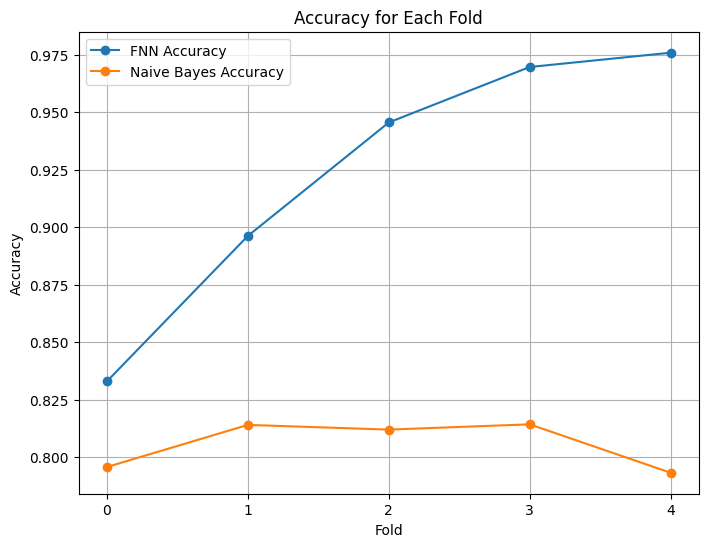

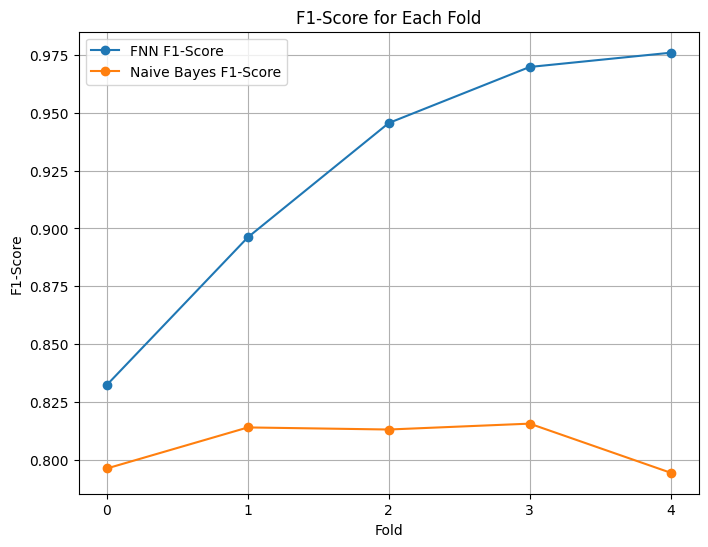

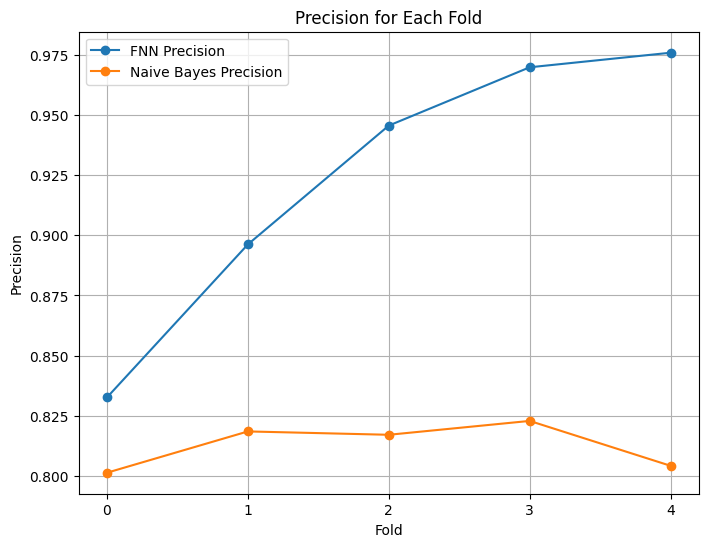

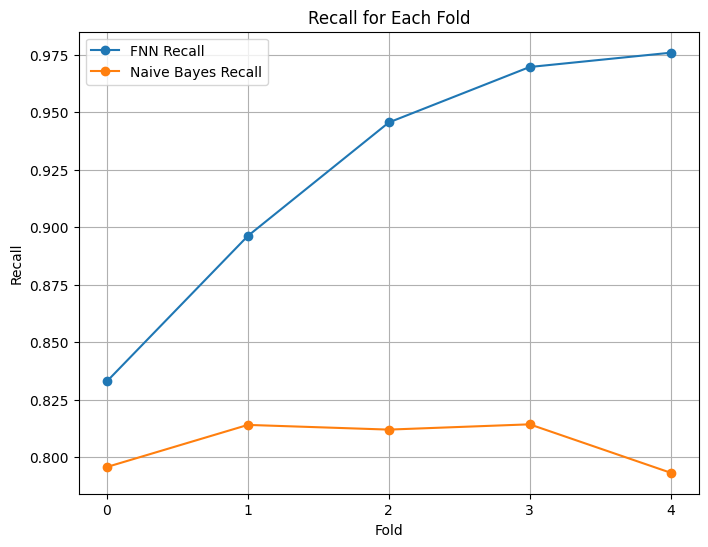

In [10]:
import matplotlib.pyplot as plt

metrics = {
    "Accuracy": [fnn_accuracies, nb_accuracies],
    "F1-Score": [fnn_f1s, nb_f1s],
    "Precision": [fnn_precisions, nb_precisions],
    "Recall": [fnn_recall, nb_recall]
}

models = ["FNN", "Naive Bayes"]

for metric_name, metric_values in metrics.items():
    plt.figure(figsize=(8, 6))
    for i, model_name in enumerate(models):
        plt.plot(metric_values[i], label=f"{model_name} {metric_name}", marker='o')
    plt.title(f"{metric_name} for Each Fold")
    plt.xlabel("Fold")
    plt.ylabel(metric_name)
    plt.xticks(range(len(metric_values[0]))) # Set x-axis ticks to fold numbers
    plt.legend()
    plt.grid(True)
    plt.show()